# 🐶 Using Transfer Learning and TensorFlow 2.0 to Classify Different Dog Breeds

Who's that doggy in the window?

Dogs are incredible. But have you ever been sitting at a cafe, seen a dog and not known what breed it is? I have. And then someone says, "it's an English Terrier" and you think, how did they know that?

In this project we're going to be using machine learning to help us identify different breeds of dogs.

To do this, we'll be using data from the [Kaggle dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview). It consists of a collection of 10,000+ labelled images of 120 different dog breeds.

This kind of problem is called multi-class image classification. It's multi-class because we're trying to classify mutliple different breeds of dog. If we were only trying to classify dogs versus cats, it would be called binary classification (one thing versus another).

Multi-class image classification is an important problem because it's the same kind of technology Tesla uses in their self-driving cars or Airbnb uses in atuomatically adding information to their listings.

Since the most important step in a deep learng problem is getting the data ready (turning it into numbers), that's what we're going to start with.

We're going to go through the following TensorFlow/Deep Learning workflow:
1. Get data ready (download from Kaggle, store, import).
2. Prepare the data (preprocessing, the 3 sets, X & y).
3. Choose and fit/train a model ([TensorFlow Hub](https://www.tensorflow.org/hub), `tf.keras.applications`, [TensorBoard](https://www.tensorflow.org/tensorboard), [EarlyStopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping)).
4. Evaluating a model (making predictions, comparing them with the ground truth labels).
5. Improve the model through experimentation (start with 1000 images, make sure it works, increase the number of images).
6. Save, sharing and reloading your model (once you're happy with the results).

For preprocessing our data, we're going to use TensorFlow 2.x. The whole premise here is to get our data into Tensors (arrays of numbers which can be run on GPUs) and then allow a machine learning model to find patterns between them.

For our machine learning model, we're going to be using a pretrained deep learning model from TensorFlow Hub.

The process of using a pretrained model and adapting it to your own problem is called **transfer learning**. We do this because rather than train our own model from scratch (could be timely and expensive), we leverage the patterns of another model which has been trained to classify images.

## Getting our workspace ready

Before we get started, since we'll be using TensorFlow 2.x and TensorFlow Hub (TensorFlow Hub), let's import them.

**NOTE:** Don't run the cell below if you're already using TF 2.x.

In [ ]:
# # At time of recording, TF 2.x is not the default
# import tensorflow as tf
# print("TF version:", tf.__version__)

# TensorFlow 2.0 is the default in Google Colab, and still is as of 07/26/2024.
# Do NOT use or run this code unless you are using a LATER version of TensorFlow.

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.15.0
Hub version: 0.16.1
GPU not available :(


To work these modules, it needs to be TensorFlow 2.15.0. Do a !pip uninstall tensorflow -y, then reinstall !pip install tensorflow==2.15.0.

In [ ]:
!pip uninstall tensorflow -y
!pip install tensorflow==2.15.0

Found existing installation: tensorflow 2.15.0
Uninstalling tensorflow-2.15.0:
  Successfully uninstalled tensorflow-2.15.0
  Using cached tensorflow-2.15.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (4.4 kB)
Using cached tensorflow-2.15.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (475.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-text 2.18.1 requires tensorflow<2.19,>=2.18.0, but you have tensorflow 2.15.0 which is incompatible.
tf-keras 2.18.0 requires tensorflow<2.19,>=2.18, but you have tensorflow 2.15.0 which is incompatible.


You might be wondering what a GPU is or why we need one. The short story is, a GPU is a computer chip which is faster at doing numerical computing. And since machine learning is all about finding patterns in numbers, that's what we're after.

Running this for the first time in Colab will let us know there's no GPU available.

This is because by default Colab runs on a computer located on Google's servers which doesn't have a GPU attached to it.

But we can fix this going to runtime and then changing the runtime type:
1. Go to Runtime.
2. Click "Change runtime type".
3. Where it says "Hardware accelerator", choose "GPU" (don't worry about TPU for now but feel free to research them).
4. Click save.
5. The runtime will be restarted to activate the new hardware, so you'll have to rerun the above cells.
6. If the steps have worked you should see a print out saying "GPU available".

If you want an example of how much a GPU speeds up computing, [Google Colab have a demonstration notebook available](https://colab.research.google.com/notebooks/gpu.ipynb).

## Getting data ready

Since much of machine learning is getting your data ready to be used with a machine learning model, we'll take extra care getting it set up.

There are a few ways we could do this. Many of them are detailed in the [Google Colab notebook on I/O (input and output)](https://colab.research.google.com/notebooks/io.ipynb).

And because the data we're using is hosted on Kaggle, we could even use the [Kaggle API](https://www.kaggle.com/docs/api).

This is great but what if the data you want to use wasn't on Kaggle?

One method is to upload it to your Google Drive, mount your drive in this notebook and import the file.

In [ ]:
# Running this cell will provide you with a token to link your drive to this notebook
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Following the prompts from the cell above, if everything worked, you should see a "drive" folder available under the Files tab.

This means we'll be able to access files in our Google Drive right in this notebook.

For this project, I've [downloaded the data from Kaggle](https://www.kaggle.com/c/dog-breed-identification/data) and uploaded it to my Google Drive as a .zip file under the folder "Data".

To access it, we'll have to unzip it.

**Note:** Running the cell below for the first time could take a while (a couple of minutes is normal). After you've run it once and got the data in your Google Drive, you don't need to run it again.

**Note 2**: Wherever you see something like `drive/My Drive/Data/` you will need to change it to wherever you are storing your files for this project. The first place you'll have to change it is the cell below.

In [ ]:
# Use the '-d' parameter as the destination for where the files should go
#!unzip "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-breed-identification.zip" -d "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification"

Once the files have been unzipped to your Google Drive, you don't have to run the cell above anymore.

### Accessing the data

Now the data files we're working with are available on our Google Drive, we can start to check it out.

Let's start with `labels.csv` which contains all of the image ID's and their assosciated dog breed (our data and labels).

# End-To-End Multi-Class Dog Breed Classification

This notebook builds an end-to-end mutli-class image classifier using TensorFlow 2.0 and TensorFlow Hub.

## 1.

Problem: Identify the breed of a dog given an image of a dog.

If a person takes a photo of a dog, the person can find out what breed of dog is in the picture.

## 2. Data

To do this, we'll be using data from the Kaggle dog breed identification competition. It consists of a collection of 10,000+ labelled images of 120 different dog breeds.

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation


## 4. Features

Some information about the data:
* We're dealing with images (unstructured data) so it's probably best we used deep learning/transfer learning.
* There are 120 breeds of dogs (this means there are 120 different classes).
*  There are around 10,000+ images in the training set (these images have labels)
*  There are around 10,000+ images in the test set (these images have no labels because they are a test set)




In [ ]:
import pandas as pd
labels_csv = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog_breed_identification/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())



                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


Looking at this, we can see there are 10222 different ID's (meaning 10222 different images) and 120 different breeds.

Let's figure out how many images there are of each breed.

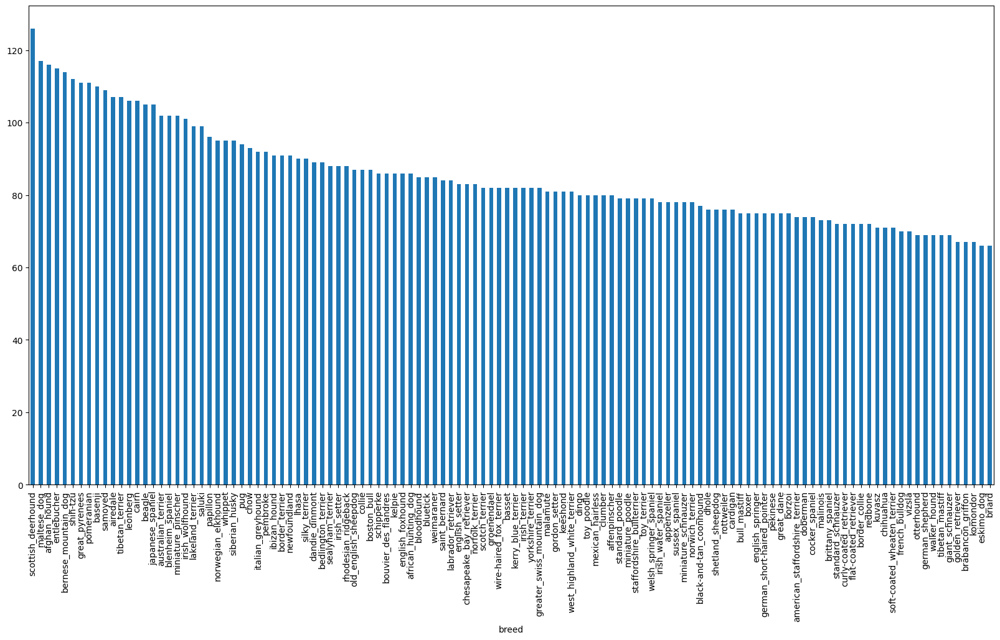

In [ ]:
# How many images are there of each breed?
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

Okay sweet. If we were to roughly draw a line across the middle of the graph, we'd see there's about 60+ images for each dog breed.

This is a good amount as for some of their vision products [Google recommends a minimum of 10 images per class to get started](https://cloud.google.com/vision/automl/object-detection/docs/prepare). And as you might imagine, the more images per class available, the more chance a model has to figure out patterns between them.

Let's check out one of the images.

**Note:** Loading an image file for the first time may take a while as it gets loaded into the runtime memory. If you see a Google Drive timeout error, check out the [Colab FAQ](https://research.google.com/colaboratory/faq.html#drive-timeout) for more.

In [ ]:
labels_csv["breed"].value_counts().median()

82.0

## Getting images and their labels

Let's get a list of all our image pathnames.

In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


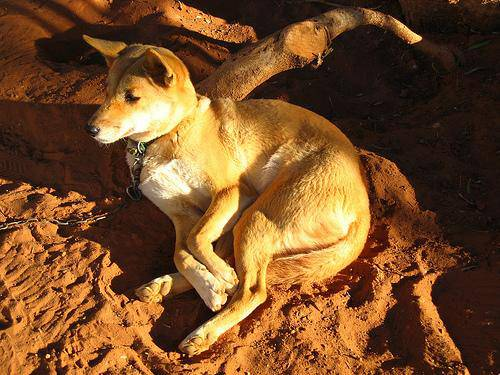

In [ ]:
# View an image
from IPython.display import display, Image
Image("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
import os
os.listdir("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train")[:10]

['e76a6bb8fdb21c7fcbb4f9f06bbda574.jpg',
 'e673bb6ca717b8dffe3b5ba35da07a83.jpg',
 'deb88665ad11440ea55963b57e9ad79c.jpg',
 'e4913c578cba8c59d842663fa734d337.jpg',
 'e399ac36963facd47d52aa56df4e6e83.jpg',
 'dd1306492b2087d880af68186b145604.jpg',
 'e13d468a13740374b13ad373d508c58c.jpg',
 'e7f2f67cb616281a89fc77a6bdea6eb0.jpg',
 'e073b458a33cbfe9b733764a1246f52e.jpg',
 'e89b8245a8e0dec55c3e6aca21e9b374.jpg']

In [ ]:
# Create pathnames from the training set
filenames = ["/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/" + fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10
filenames[:10]

['/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/002

In [ ]:
# Check whether the number of filenames matches the number of  actual image files
import os
if len(os.listdir("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train")) == len(labels_csv):
  print("Filenames match the actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory!")

Filenames match the actual amount of files!


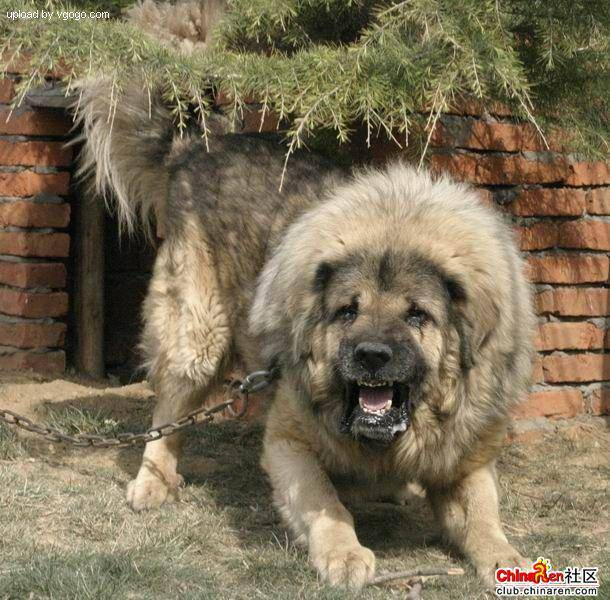

In [ ]:
# Check an image directly from a filepath
Image(filenames[9000])

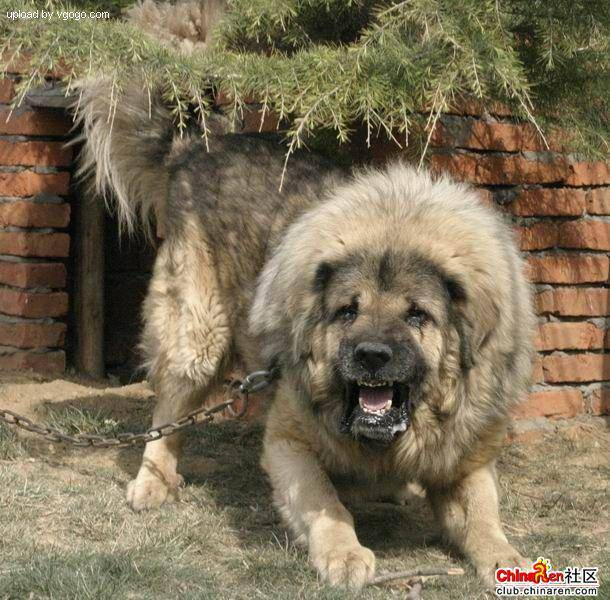

In [ ]:
from IPython.display import display, Image
Image("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/e20e32bf114141e20a1af854ca4d0ecc.jpg")

In [ ]:
labels_csv["id"][9000]

'e20e32bf114141e20a1af854ca4d0ecc'

In [ ]:
labels_csv["breed"][9000]

'tibetan_mastiff'

# Since there are now training image file paths in a list, it's time to prepare the labels.

In [ ]:
import numpy as np
labels = labels_csv["breed"].to_numpy()
# labels = np.array(labels) # Does the same thing as above
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
# See if the number of labels matches the number of file names
if len(labels) == len(filenames):
  print("Number of labels matches number of file names!")
else:
  print("Number of labels does not match number of filenames, check data directories!")

Number of labels matches number of file names!


The labels are strings, so they must be converted into numbers.

In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
len(unique_breeds)

120

In [ ]:
# Turn a single label into an array of booleans
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into a Boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(boolean_labels)

10222

In [ ]:
# Example: Turning  a Boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # Index where label occurs
print(boolean_labels[0].argmax()) # Index where label occurs in the Boolean array
print(boolean_labels[0].astype(int)) #  There will be a 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
print(labels[2]) # original label
print(boolean_labels[2].astype(int)) #  There will be a 1 where the sample label occurs

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
filenames[:10]

['/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/002

In [ ]:
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

### Creating a validation set
Kaggle does NOT have a validation set.
A validation set is like a practice exam.
The test set is the final exam.

In [ ]:
# Set up X and y variables
#X i s the standard variable for the data and y is the standard variable for the label
X = filenames
y = boolean_labels

In [ ]:
len(filenames)

10222

This starts experimenting with ~1000 images and increase as needed.

Colab has an extremely useful slider.

In [ ]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [ ]:
# Split the data into train and validation sets
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size of NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                    y[:NUM_IMAGES],
                                                    test_size=0.2,
                                                    random_state=42)

# Get the data into the right shape
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
# Lookiing at the training data
X_train[:5], y_train[:2]

(['/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, F

# Preprocessing images (turning images into tensors)

To preprocess images into Tensors, write a function which does several things:
1. Take an image file path as an input.
2. Use Tensorflow to read the file and save it to a variable, "image".
3. Turn our "image" (a jpg) into Tensors.
5. Return a modified image.



Information on how to use TensorFlow can be found here:
https://www.tensorflow.org/guide/data

and here:

https://www.tensorflow.org/tutorials/load_data/images

Before working down the list, here is an example of what importing an image looks like.

You will get a tuple like this for the shape:
(257, 350, 3)
That is height, width, and channel.
The channel is the RGB number from 0 to 255.


In [ ]:
# Convert image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42]) # read in an image
image.shape

(257, 350, 3)

In [ ]:
# Convert image to NumPy array using cv2 instead
import cv2
import numpy as np
image = cv2.imread(filenames[42]) # read in an image
image.shape

(257, 350, 3)

In [ ]:
import tensorflow as tf
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 61, 111,  63],
        ...,
        [ 86, 133,  77],
        [ 86, 134,  76],
        [ 86, 134,  76]],

       [[ 75, 119,  72],
        [ 68, 114,  67],
        [ 64, 110,  63],
        ...,
        [ 84, 131,  75],
        [ 84, 132,  74],
        [ 84, 132,  74]]], dtype=uint8)>

To preprocess images into Tensors, write a function which does several things:

1. Take an image file path as an input.
2. Use Tensorflow to read the file and save it to a variable, "image".
3. Turn the "image" (a jpg) into Tensors.
4.Normalize the image  (convert color channel values from 0-255  to 0-1)
5. Resize the image in the shape of (224, 224)
6. Return a modified image.

In [ ]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensors with 3 color channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
    # Convert the color channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image


## Turning data into batches

Data goes into batches to fit into memory. 10,000+ images is far to big to fit in memory.

That's why the standard is to use 32 as a batch size for images at one time. The batch size can be manually adjusted if need be.

In order to use TensorFlow effectively, we need the data in the form of Tensor tuples which look like this: (image, label).



In [ ]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label, processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# (process_image(filenames[42]), boolean_labels[42])
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117759],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now that there is a way to turn the data into tuples of Tensors in the form of : (image, label), now it is time to make a function to turn all of the data (X and y) into batches.

In [ ]:
# Define the batch size, 32 is a good start. TF does default to 32, but make it a constant anyway!
BATCH_SIZE = 32

# Create a function to turn data into batches (training, validation, test sets)
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  It shuffles the data if it is training data but doesn't shuffle it if it is validation data.
  It also accepts test data as input (no labels). No labels for test data!
  """
  # If the data is a test dataset, we don't have labels:
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # Only file paths, no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE) # Turns data into a batch size of 32
    return data_batch

  # If the data is a valid data set, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # File paths
                                               tf.constant(y))) # Labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else: # If the data is a training set, should shuffle it
      print("Creating training data batches...")
      data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # File paths
                                                                         tf.constant(y))) # Labels

      # Shuffling pathnames and labels before mapping image processor function is faster than
      # shuffling images
      data = data.shuffle(buffer_size=len(X)) # Shuffling all of them

      # Create (image, label) tuples (this also turns the image path into a preprocessed image)
      data = data.map(get_image_label) # Processing label

      # Turn the training data into batches
      data_batch = data.batch(BATCH_SIZE)
  return data_batch


In [ ]:
# Creating training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing data batches

The data is in batches, but is a little hard to understand without visualization.

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Set up the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25  (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1) # (rows, columns, index)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis("off")

To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the [`as_numpy_iterator()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator) method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to [`next()`](https://docs.python.org/3/library/functions.html#next) will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.

**Note:** Running the cell below and loading images may take a little while.

In [ ]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
train_images[0].shape

(224, 224, 3)

In [ ]:
len(train_images), len(train_labels)

(32, 32)

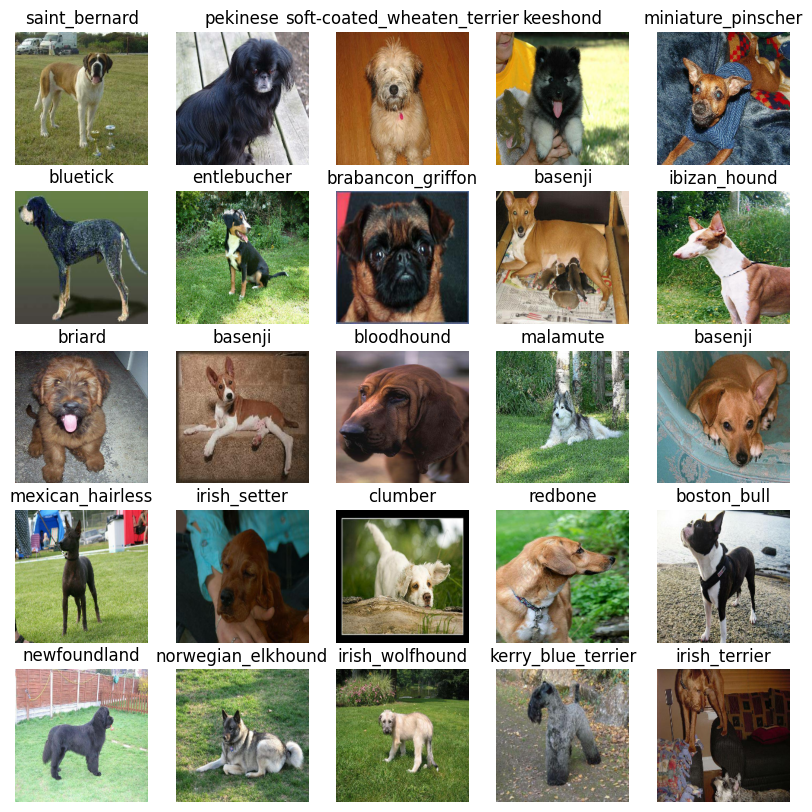

In [ ]:
# Visualizing the data in a training batch
show_25_images(train_images, train_labels)

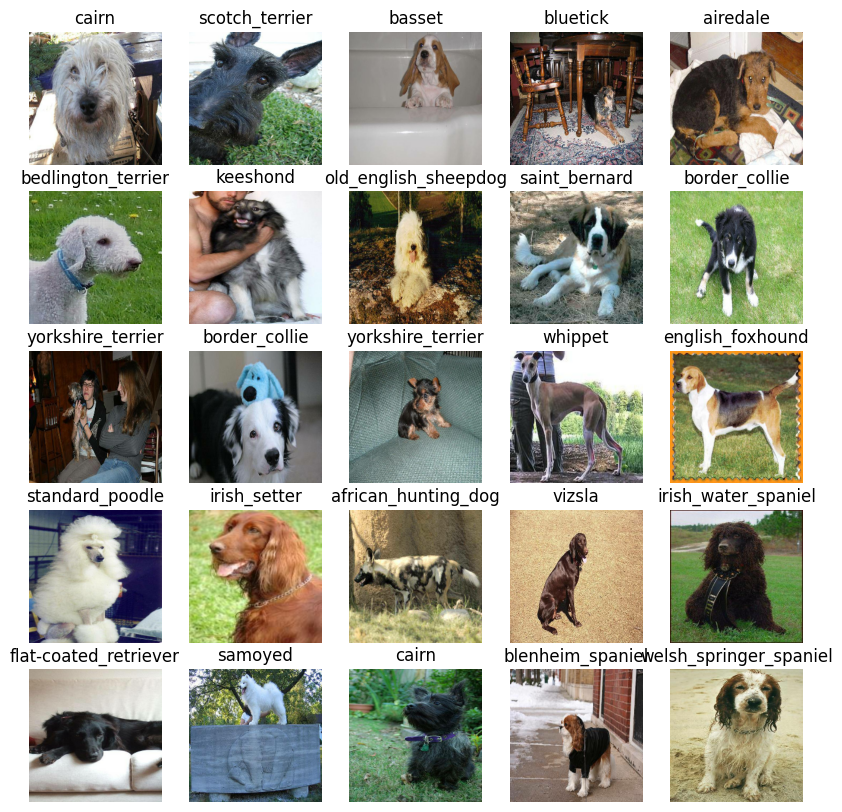

In [ ]:
# Vizualizing the validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

### Before building a model

Before building a model, these things need defining:
* The **input shape** (our images' shape, in the form of Tensors) to our model.
* The **output shape** (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use (TensorHub).

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

There are now inputs, outputs, and the model ready to go. Now they must be put together in a Keras deep learning model.

Knowing this, there must be a function to:
* Take the input shape, output shape, and model chosen as parameters.
* Defines the layers of the sequential Keras model (this problem does NOT use the functional Keras model) in a sequential fashion (do this, next this, and then that).
* Compiles the model (says it should be evaluated and improved).
* Builds the model (tells the model what shape to use)
* Returns the model

All of these steps can be found here: https://www.tensorflow.org/guide/keras

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE,
                 output_shape=OUTPUT_SHAPE,
                 model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this
       #(how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

Setting up the model layers
There are two ways to do this in Keras, the functional and sequential API. We've used the sequential.

Which one should you use?

The Keras documentation states the functional API is the way to go for defining complex models but the sequential API (a linear stack of layers) is perfectly fine for getting started, which is what we're doing.

The first layer we use is the model from TensorFlow Hub (hub.KerasLayer(MODEL_URL). So our first layer is actually an entire model (many more layers). This input layer takes in our images and finds patterns in them based on the patterns mobilenet_v2_130_224 has found.

The next layer (tf.keras.layers.Dense()) is the output layer of our model. It brings all of the information discovered in the input layer together and outputs it in the shape we're after, 120 (the number of unique labels we have).

The activation="softmax" parameter tells the output layer, we'd like to assign a probability value to each of the 120 labels somewhere between 0 & 1. The higher the value, the more the model believes the input image should have that label. If we were working on a binary classification problem, we'd use activation="sigmoid".

For more on which activation function to use, see the article Which Loss and Activation Functions Should I Use?

Compiling the model
This one is best explained with a story.

Let's say you're at the international hill descending championships. Where your start standing on top of a hill and your goal is to get to the bottom of the hill. The catch is you're blindfolded.

Luckily, your friend Adam is standing at the bottom of the hill shouting instructions on how to get down.

At the bottom of the hill there's a judge evaluating how you're doing. They know where you need to end up so they compare how you're doing to where you're supposed to be. Their comparison is how you get scored.

Transferring this to model.compile() terminology:

loss - The height of the hill is the loss function, the models goal is to minimize this, getting to 0 (the bottom of the hill) means the model is learning perfectly.
optimizer - Your friend Adam is the optimizer, he's the one telling you how to navigate the hill (lower the loss function) based on what you've done so far. His name is Adam because the Adam optimizer is a great general which performs well on most models. Other optimizers include RMSprop and Stochastic Gradient Descent.
metrics - This is the onlooker at the bottom of the hill rating how well your perfomance is. Or in our case, giving the accuracy of how well our model is predicting the correct image label.
Building the model
We use model.build() whenever we're using a layer from TensorFlow Hub to tell our model what input shape it can expect.

In this case, the input shape is [None, IMG_SIZE, IMG_SIZE, 3] or [None, 224, 224, 3] or [batch_size, img_height, img_width, color_channels].

Batch size is left as None as this is inferred from the data we pass the model. In our case, it'll be 32 since that's what we've set up our data batches as.

Now we've gone through each section of the function, let's use it to create a model.

We can call summary() on our model to get idea of what our model looks like.

In [ ]:
# Create a model and check its details
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.optimizers import SGD
import tensorflow_hub as hub

model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


## Creating Callbacks
**Callbacks** are helper functions a model can use during training such as save it progress, save its progress, and stop training early if a model stops improving before it overfits.

We'll create two callbacks, one for TensorBoard which helps track our model's progress, and another for early stopping which prevents our model for training too long (overfitting).

### TensorBoard Callback
To set up a TensorBoard callback, do 3 things:
1. Load the TensorBoard notebook extension (%load_ext tensorboard).
2. Createt a TensorBoard callback  which is able to save logs to a directory and pass it to our model's **fit function **.
3. Visualize our model's training logs with the %tensorboard magic function after model training.



In [ ]:
# Load TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
import datetime # Keep track of the experiment by the time the experiment ran

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  # Set up a logs file in the Dog Vision folder first!
  logdir = os.path.join("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/logs",
                        # Make it so the logs get tracked whenever we run  an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  print(f"Saving TensorBoard log files to: {logdir}")
  return tf.keras.callbacks.TensorBoard(logdir)


### Early Stopping Callback

Early stopping stops the model fom overfitting by stopping training if a certain evaluation metric stops improving.



In [ ]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # This stops after 3 epochs

### Training a model (on a subset of data_

The first model is only going to train on 1000 images to make sure everything is working.


In [ ]:
# How many rounds should the model look through the data?
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [ ]:
# Make sure you are using a GPU, which is 30X faster
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU not available :(


## Creating a function that trains a model.

* Create a model using **create model**.
* Set up a TensorBorad callback using **create_tensorboard_callback()**
* Call the **fit() function** on the model, passing it the training data, validation data, number of epochs to train for (NUM_EPOCHS) and the callbacks we'd like to use
* Return the model


In [ ]:
# Build a function to train a model and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data, passing it to the created callbacks
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  # Return the fitted model
  return model

**Note:** When training a model for the first time, the first epoch will take a while to load compared to the rest. This is because the model is getting ready and the data is being initialized. Using more data will generally take longer, which is why we've started with ~1000 images. After the first epoch, subsequent epochs should take a few seconds.

In [ ]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Saving TensorBoard log files to: /content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/logs/20250224-043513
Epoch 1/100
25/25 [==============================] - 314s 12s/step - loss: 4.5485 - accuracy: 0.1013 - val_loss: 3.3256 - val_accuracy: 0.2650
Epoch 2/100
25/25 [==============================] - 64s 3s/step - loss: 1.5984 - accuracy: 0.7113 - val_loss: 2.1014 - val_accuracy: 0.5400
Epoch 3/100
25/25 [==============================] - 64s 3s/step - loss: 0.5524 - accuracy: 0.9388 - val_loss: 1.6267 - val_accuracy: 0.6050
Epoch 4/100
25/25 [==============================] - 55s 2s/step - loss: 0.2463 - accuracy: 0.9900 - val_loss: 1.4342 - val_accuracy: 0.6450
Epoch 5/100
25/25 [==============================] - 58s 2s/step - loss: 0.1453 - accuracy: 0.9975 - val_loss: 1.3627 - val_accuracy: 0.6450
Epoch 6/100
25/25 [==========================

**Question:** It looks like our model might be overfitting (getting far better results on the training set than the validation set), what are some ways to prevent model overfitting? Hint: this may involve searching something like "ways to prevent overfitting in a deep learning model?".

**Note:** Overfitting to begin with is a good thing. It means our model is learning something.

#### Checking the TensorBoard logs
Now our model has been trained, we can make its performance visual by checking the TensorBoard logs.

The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and visualize its contents.

In [ ]:
# This is the trainer's version
# %tensorboard --logdir drive/My\ Drive/Data/logs

In [ ]:
%tensorboard --logdir "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/logs"

Output hidden; open in https://colab.research.google.com to view.

Thanks to our `early_stopping` callback, the model stopped training after 26 or so epochs (in my case, yours might be slightly different). This is because the validation accuracy failed to improve for 3 epochs.

But the good new is, we can definitely see our model is learning something. The validation accuracy got to 65% in only a few minutes.

This means, if we were to scale up the number of images, hopefully we'd see the accuracy increase.

## Making and evaluating predictions using a trained model

Before we scale up and train on more data, let's see some other ways we can evaluate our model. Because although accuracy is a pretty good indicator of how our model is doing, it would be even better if we could see it in action.

Making predictions with a trained model is as calling `predict()` on it and passing it data in the same format the model was trained on.

In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Make predictions on the validation data (not the training data)
predictions = model.predict(val_data, verbose=1)
predictions

7/7 [==============================] - 12s 1s/step


array([[5.44473238e-04, 2.64879898e-04, 5.34438121e-04, ...,
        1.02773956e-04, 3.21919615e-05, 4.45032911e-03],
       [3.29895481e-03, 6.39607140e-04, 3.84824560e-03, ...,
        4.61192249e-04, 3.43986065e-03, 5.49683173e-04],
       [4.74238914e-05, 8.97805076e-05, 5.54348953e-05, ...,
        2.33839310e-05, 1.33541471e-04, 1.04708151e-05],
       ...,
       [5.17176022e-06, 1.32319605e-04, 1.65780584e-04, ...,
        7.87967747e-06, 6.17025216e-05, 8.08119585e-05],
       [1.00952955e-02, 1.39327429e-04, 9.88208340e-05, ...,
        2.17112887e-04, 1.62727549e-04, 2.50045061e-02],
       [1.53013942e-04, 1.52667399e-05, 8.86052847e-04, ...,
        7.06526334e-04, 1.60450779e-03, 3.38518839e-05]], dtype=float32)

In [ ]:
np.sum(predictions[0])

1.0

In [ ]:
predictions.shape

(200, 120)

In [ ]:
len(y_val)

200

In [ ]:
# The len(y_val) should equal the len(unique_breeds)
len(unique_breeds)

120

Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (200 images) returns an array (`predictions`) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

In [ ]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[5.44473238e-04 2.64879898e-04 5.34438121e-04 1.32309287e-04
 2.03254574e-04 8.30645422e-06 3.76689024e-02 6.34324271e-04
 1.69005507e-04 6.96144940e-04 1.14659686e-03 1.52753375e-04
 1.00334478e-03 3.47411988e-04 2.36690263e-04 3.02946602e-04
 2.52143200e-05 1.04685120e-01 1.53078508e-05 9.35249627e-05
 1.13880017e-03 9.91553825e-05 9.69020130e-06 6.29895600e-04
 5.60011067e-05 3.22863489e-04 2.48807430e-01 1.55095709e-04
 1.05353503e-03 6.13411685e-05 2.66821560e-04 1.10847247e-03
 3.25056433e-04 5.33112579e-05 1.08388216e-04 5.56590296e-02
 1.57352606e-05 8.60352127e-04 1.02136895e-04 9.86417290e-05
 6.89526380e-04 1.68931147e-05 4.33291018e-04 2.26219607e-04
 1.01262494e-05 1.07932290e-04 5.07497389e-05 1.88682636e-03
 6.00580752e-05 4.36529663e-04 5.49415709e-04 3.06185757e-05
 9.55203577e-05 8.04154915e-05 4.52306122e-05 1.05862258e-04
 5.58970845e-04 7.53996719e-04 2.46221869e-04 1.32390693e-01
 2.03516902e-04 7.44509452e-05 1.45178684e-03 2.58438140e-05
 3.23972956e-04 3.432679

In [ ]:
# First prediction
print(predictions[42])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[7.69770486e-05 2.72087433e-04 8.49814387e-05 2.94843103e-05
 2.09850748e-03 2.55631858e-05 2.41891947e-04 9.14144679e-04
 2.73631066e-02 1.47691388e-02 3.20035433e-05 2.02079354e-05
 1.20437169e-03 2.01115012e-03 3.95847892e-04 1.10237515e-02
 1.09825478e-05 2.52735481e-04 1.05606807e-04 1.35138491e-03
 2.90423723e-05 6.87153370e-04 2.79819760e-05 3.48124449e-05
 2.43576150e-02 9.55209616e-05 8.71385419e-05 1.83202617e-04
 1.40621400e-04 1.23669724e-05 7.34422065e-05 2.91706419e-05
 8.03480143e-05 2.97910065e-05 5.84679728e-05 3.02287663e-05
 1.76588961e-04 2.62062124e-04 1.32536559e-04 2.20702663e-01
 1.75619760e-04 6.07982565e-06 5.55583416e-03 5.23725475e-06
 7.92889623e-05 7.73540523e-05 1.27788269e-04 8.18244764e-04
 2.04370954e-05 4.76534537e-04 2.31504691e-05 1.60781638e-04
 3.42245359e-04 8.40038760e-04 9.76597494e-06 5.91899035e-04
 9.18075821e-05 1.01767488e-04 2.72291581e-05 3.68004585e-05
 9.21380779e-05 2.58281972e-04 1.59452698e-04 1.65683414e-05
 3.14886274e-05 2.361803

## Having the above functionality is good, but it should be done at scale.

## It would also be better to see the image the image is being made on.

**Note: ** Prediction probabilities are also known as confidence levels.

In [ ]:
# Turn prediction probabilities into their respective labels (easy to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array or prediction probabilites
pred_label = get_pred_label(predictions[81])
pred_label

'dingo'

In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

Now that there is a list of all different predictions our model has made, this must be done for the validation images and validation labels.

Remember, the model hasn't trained on the validation data, during the `fit()` function, it only used the validation data to evaluate itself. So the validation images can be used to visually compare the model's predictions with the validation labels.

Since the validation data (`val_data`) is in batch form, to get a list of validation images and labels, they must be unbatched  (using [`unbatch()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#unbatch)) and then turn it into an iterator using [`as_numpy_iterator()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator).

A small function will do these things.

In [ ]:
# Create a function to unbatch a batched data set (using unbatch())
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [ ]:
get_pred_label(predictions[0])

'cairn'

Now there ways to get:
* Prediction labels
* Validation labels (truth labels)
* Validation images

It is time to make some functions to make these all a bit more able to visualize.

More specifically, it is desired  to be able to view an image, its predicted label and its actual label (true label).

The first function to create will:
* Take an array of prediction probabilities, an array of truth labels, an array of images and an integer.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and target image on a single plot.

In [ ]:
import matplotlib.pyplot as plt

def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)


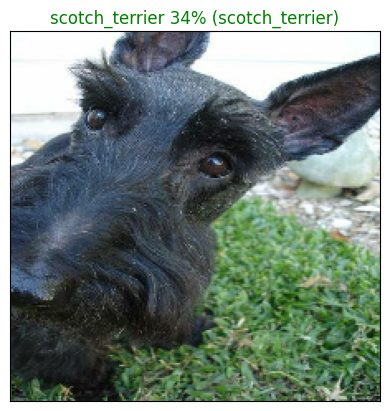

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

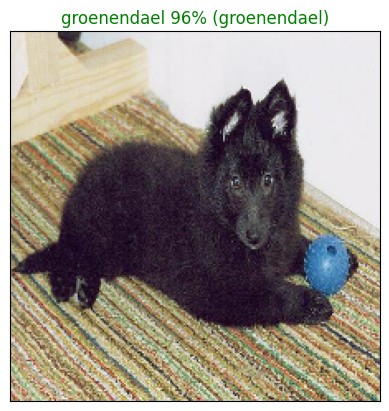

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=77)

Making functions to help visualize models results are really helpful in understanding how the model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:
* Take an input of a prediction probabilities array, a ground truth labels array and an integer.
* Find the predicted label using `get_pred_label()`.
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels, coloring the true label green.

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top ten prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Set up plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass


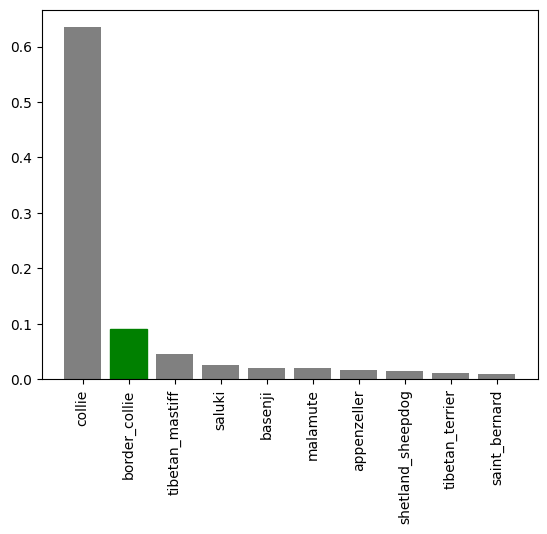

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

 Now that there are some functions to help visualize predictions and evaluate the model, a function will check out a few.

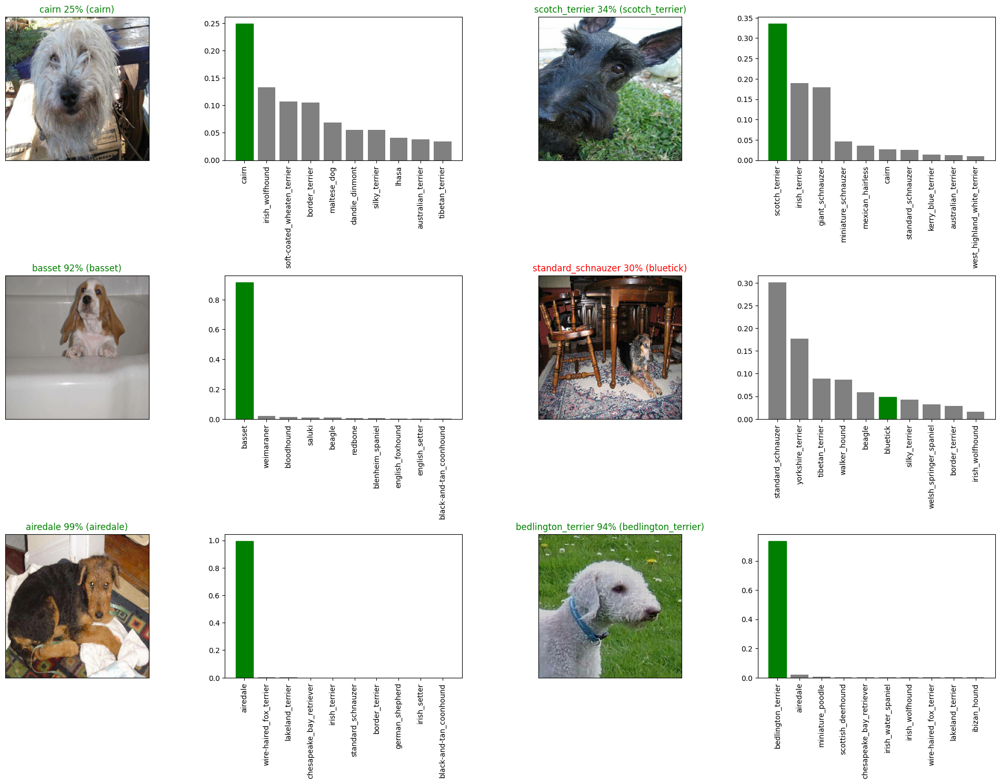

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show();

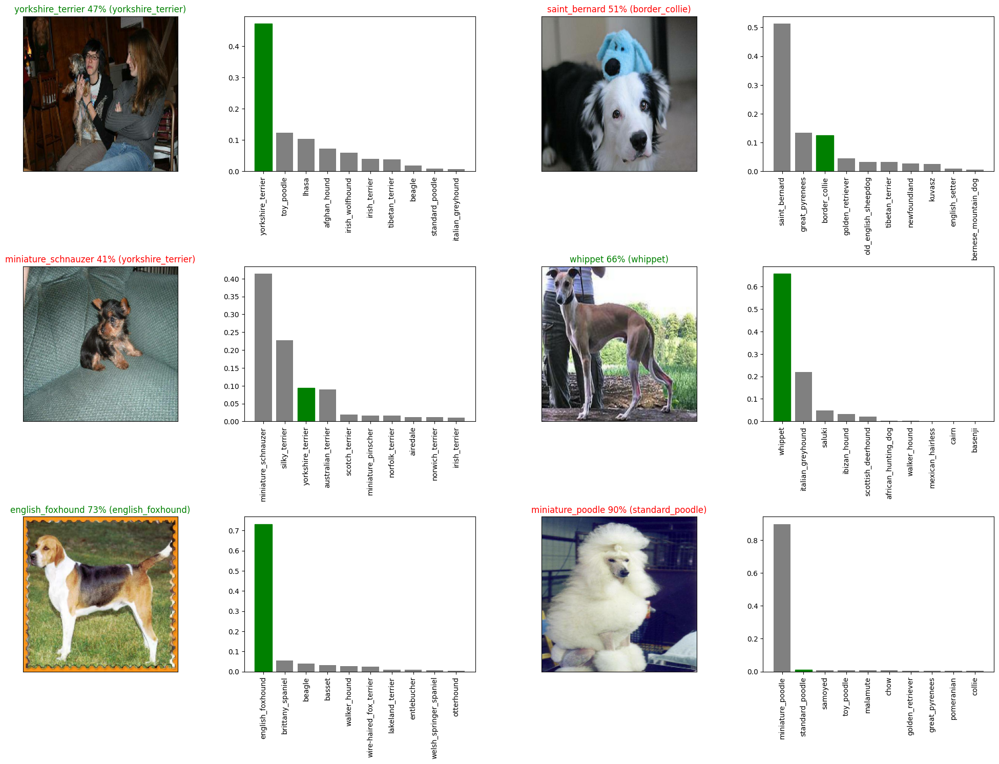

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 10
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show();

## Saving and reloading a model

After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an [entire saved Keras model is h5](https://www.tensorflow.org/tutorials/keras/save_and_load). So we'll make a function which can take a model as input and utilize the [`save()`](https://www.tensorflow.org/tutorials/keras/save_and_load#savedmodel_format) method to save it as a h5 file to a specified directory.

In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  model_path = modeldir + "-" + suffix + ".h5" # Save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: /content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20250224-045623-1000-images-Adam.h5...


/usr/local/lib/python3.11/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20250224-045623-1000-images-Adam.h5'

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Load our model trained on 1000 images
model_1000_images = load_model("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20240730-075113-1000-images-Adam.h5")

Loading saved model from: /content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20240730-075113-1000-images-Adam.h5


Compare the two models (the original one and loaded one). We can do so easily using the evaluate() method.

In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 12s 2s/step - loss: 1.2094 - accuracy: 0.6800


[1.2094449996948242, 0.6800000071525574]

In [ ]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 15s 2s/step - loss: 1.3001 - accuracy: 0.6500


[1.3001067638397217, 0.6499999761581421]

## Training a big dog model on the full data.

In [ ]:
# Remind about the length of the X and y sets
len(X), len(y)

(10222, 10222)

In [ ]:
X[:10]

['/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/002

In [ ]:
# These are labels for each file path in Boolean arrays. One should be True.
y[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
!pip uninstall tensorflow -y
!pip install tensorflow==2.15.0

Found existing installation: tensorflow 2.15.0
Uninstalling tensorflow-2.15.0:
  Successfully uninstalled tensorflow-2.15.0
  Using cached tensorflow-2.15.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (4.4 kB)
Using cached tensorflow-2.15.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (475.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-text 2.18.1 requires tensorflow<2.19,>=2.18.0, but you have tensorflow 2.15.0 which is incompatible.
tf-keras 2.18.0 requires tensorflow<2.19,>=2.18, but you have tensorflow 2.15.0 which is incompatible.


In [ ]:
# Create a data batch with the full data set
full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Create a function which builds a Keras model
# Create a model and check its details
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.optimizers import SGD
import tensorflow_hub as hub

def create_model(input_shape=INPUT_SHAPE,
                 output_shape=OUTPUT_SHAPE,
                 model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this
       #(how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [ ]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all th data, can't monitor validation accuracy to prevent overfitting
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience=3)

Saving TensorBoard log files to: /content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/logs/20250224-045740


In [ ]:
print("TF version:", tf.__version__)

TF version: 2.15.0


THIS MODEL WILL TAKE UP TO 30 MINUTES TO RUN because the GPU has to upload all the images.

In [ ]:
# Fit the full model to the full data
# Create a model and check its details
# import keras
# from keras.models import Sequential
# from keras.layers import InputLayer, Dense, Dropout, Activation
# from keras.optimizers import SGD
# from keras import optimizers

 # Instantiating full_model
# full_model = full_model()

# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks =[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 3103s 10s/step - loss: 1.3045 - accuracy: 0.6777
Epoch 2/100
320/320 [==============================] - 567s 2s/step - loss: 0.3943 - accuracy: 0.8819
Epoch 3/100
320/320 [==============================] - 583s 2s/step - loss: 0.2343 - accuracy: 0.9348
Epoch 4/100
320/320 [==============================] - 580s 2s/step - loss: 0.1511 - accuracy: 0.9641
Epoch 5/100
320/320 [==============================] - 571s 2s/step - loss: 0.1054 - accuracy: 0.9778
Epoch 6/100
320/320 [==============================] - 566s 2s/step - loss: 0.0767 - accuracy: 0.9878
Epoch 7/100
320/320 [==============================] - 577s 2s/step - loss: 0.0575 - accuracy: 0.9907
Epoch 8/100
320/320 [==============================] - 572s 2s/step - loss: 0.0447 - accuracy: 0.9947
Epoch 9/100
320/320 [==============================] - 575s 2s/step - loss: 0.0370 - accuracy: 0.9958
Epoch 10/100
320/320 [==============================] - 573s 2s/step - loss: 0.0

In [ ]:
save_model(full_model, suffix="full-model-Adam")

Saving model to: /content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20250224-084922-full-model-Adam.h5...


'/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20250224-084922-full-model-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = "drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20240812-091705-full-model-Adam.h5"

In [ ]:
len(X)

10222

Making predictions on the test dataset.

Since the model has been trained on images in the form of Tensor batches, to make predictions on the test data, it must be converted into the same format.

There is a "create data batches()" function in this file that can take a list of filenames as an input and convert them into Tensor batches.

To make predictions on the test data, it is needed to:
* Get the test image filenames ☑
* Convert the filenames into test data batches useing "create data batches()" function and setting the "test_data" parameter to true (since the test data doesnt have labels).
* Make a predictions array by passing the test batches into the "predict()" method called on the model.

In [ ]:
# Load test image filenames
import os
test_path = "drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste1dd78810048dc387573f2ec50e4bb16.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste293d06016cac647cd289e2008a4623a.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste5f2204119380ce1a17fd09435c5012a.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste527455253416f809a73886b6003020d.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste386eaa78980be7183ecfdd32ecd2aab.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste4c37f2fbeabc98e168ebf4abce59370.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/teste752d87634c6177a748d655a55aeec89.jpg',
 'drive/My Drive/Colab Notebooks/Z

In [ ]:
len(test_filenames)

10357

In [ ]:
# Create test data batch
#import tensorflow as tf
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

# If you are not running TensorFlow 2.15, uninstall TensorFlow and reinstall it above.

# Note: Calling "predict()" on our full model and passing it in the test data batch will take a long time to run (on a GPU, about an hour.)

In [ ]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

AttributeError: 'str' object has no attribute 'predict'

In [ ]:

import tensorflow as tf
from keras.models import Sequential
from keras.layers import InputLayer, Dense, Dropout, Activation
from keras.optimizers import SGD
from keras import optimizers

loaded_full_model=tf.keras.models.load_model("drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20240812-091705-full-model-Adam.h5")
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

ValueError: Unknown layer: 'KerasLayer'. Please ensure you are using a `keras.utils.custom_object_scope` and that this object is included in the scope. See https://www.tensorflow.org/guide/keras/save_and_serialize#registering_the_custom_object for details.

In [ ]:
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.15.0
Hub version: 0.16.1
GPU not available :(


In [ ]:
# Create a function which builds a Keras model
# Create a model and check its details
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.optimizers import SGD
import tensorflow_hub as hub

def create_model(input_shape=INPUT_SHAPE,
                 output_shape=OUTPUT_SHAPE,
                 model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this
       #(how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [ ]:
optimizer=tf.keras.optimizers.Adam()
loaded_full_model = tf.keras.models.load_model("drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20240812-091705-full-model-Adam.h5", custom_objects={'KerasLayer':hub.KerasLayer , 'Adam': optimizer})


In [ ]:
# This code is from Stack Overflow
loaded_full_model= tf.keras.models.load_model(
       ("drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/20240812-091705-full-model-Adam.h5"),
       custom_objects={'KerasLayer':hub.KerasLayer}
)

In [ ]:
# Make predictions on test data batch using the loaded full model
import tensorflow as tf
import numpy as np
import tensorflow_hub as hub
import keras
from keras.models import Sequential
from keras.layers import InputLayer, Dense, Dropout, Activation
from keras.optimizers import SGD
from keras import optimizers

test_filenames = ["drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/" + fname for fname in os.listdir("drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test")]
test_data = create_data_batches(test_filenames, test_data=True)
test_predictions = loaded_full_model.predict(test_data,
                                            verbose=1)

Creating test data batches...
324/324 [==============================] - 3474s 11s/step


In [ ]:
# Save predictions (NumPy array) to CSV file (for access later)
np.savetext("drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test_predictions/preds_array.csv",
            test_predictions,
            delimiter=",")

AttributeError: module 'numpy' has no attribute 'savetext'

In [ ]:
# Load predictions
test_predictions = np.loadtext("drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/preds_array.csv",
                               delimiter=",")

AttributeError: module 'numpy' has no attribute 'loadtext'

In [ ]:
# Using the file in the zero-to-mastery file
import numpy as np
import pandas as pd

test_predictions = pd.read_csv("/content/dog-vision-prediction-probabilites-array.csv")

FileNotFoundError: [Errno 2] No such file or directory: '/content/dog-vision-prediction-probabilites-array.csv'

In [ ]:
# Check out the test predictions
test_predictions[:10]

array([[5.64553284e-06, 2.25255592e-09, 6.85365209e-10, ...,
        4.26884750e-09, 8.38502388e-07, 5.99106613e-07],
       [3.90430084e-11, 4.25156681e-11, 2.36500403e-11, ...,
        4.48079718e-14, 1.68591887e-12, 5.66061826e-05],
       [1.96748645e-10, 1.67817031e-08, 1.54595114e-10, ...,
        5.84640418e-07, 5.34995825e-10, 8.34705360e-11],
       ...,
       [2.74083642e-12, 6.71347179e-12, 6.56837162e-15, ...,
        3.59812839e-11, 7.72321374e-11, 2.08602843e-13],
       [1.53135005e-11, 1.15745928e-11, 3.55870845e-12, ...,
        2.96716229e-09, 1.06781826e-10, 9.81801663e-13],
       [1.49757875e-06, 3.11871099e-06, 4.26911669e-07, ...,
        1.29695650e-06, 1.46755508e-09, 7.04222902e-09]], dtype=float32)

In [ ]:
test_predictions.shape

(10357, 120)

## Preparing test dataset predictions for Kaggle

On the Kaggle sample submission page, Kaggle wants the model's prediction probability outputs in a DataFrame with an ID column for each different dog breed.
https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

To get the data in this format, one must:
* Create a pandas DataFrame with an ID column as well as a column for each dog breed 🗹
* Add data to the ID column by extracting the test image IDs from their file paths 🗹
* Add data (the prediction probabilities) to each of the dog breed columns. 🗹
* Export the DataFrame as a CSV to submit it to Kaggle. 🗹


In [ ]:
list(unique_breeds)

['affenpinscher',
 'afghan_hound',
 'african_hunting_dog',
 'airedale',
 'american_staffordshire_terrier',
 'appenzeller',
 'australian_terrier',
 'basenji',
 'basset',
 'beagle',
 'bedlington_terrier',
 'bernese_mountain_dog',
 'black-and-tan_coonhound',
 'blenheim_spaniel',
 'bloodhound',
 'bluetick',
 'border_collie',
 'border_terrier',
 'borzoi',
 'boston_bull',
 'bouvier_des_flandres',
 'boxer',
 'brabancon_griffon',
 'briard',
 'brittany_spaniel',
 'bull_mastiff',
 'cairn',
 'cardigan',
 'chesapeake_bay_retriever',
 'chihuahua',
 'chow',
 'clumber',
 'cocker_spaniel',
 'collie',
 'curly-coated_retriever',
 'dandie_dinmont',
 'dhole',
 'dingo',
 'doberman',
 'english_foxhound',
 'english_setter',
 'english_springer',
 'entlebucher',
 'eskimo_dog',
 'flat-coated_retriever',
 'french_bulldog',
 'german_shepherd',
 'german_short-haired_pointer',
 'giant_schnauzer',
 'golden_retriever',
 'gordon_setter',
 'great_dane',
 'great_pyrenees',
 'greater_swiss_mountain_dog',
 'groenendael',


In [ ]:
# Create a Pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
test_filenames

['drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e1dd78810048dc387573f2ec50e4bb16.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e293d06016cac647cd289e2008a4623a.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e5f2204119380ce1a17fd09435c5012a.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e527455253416f809a73886b6003020d.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e386eaa78980be7183ecfdd32ecd2aab.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e4c37f2fbeabc98e168ebf4abce59370.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/e752d87634c6177a748d655a55aeec89.jpg',
 'drive/My Drive/Colab Note

In [ ]:
# Append test image IDs to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
test_ids[:10]

['e1dd78810048dc387573f2ec50e4bb16',
 'e293d06016cac647cd289e2008a4623a',
 'e5f2204119380ce1a17fd09435c5012a',
 'e527455253416f809a73886b6003020d',
 'e386eaa78980be7183ecfdd32ecd2aab',
 'e4c37f2fbeabc98e168ebf4abce59370',
 'e752d87634c6177a748d655a55aeec89',
 'e57820007fcc2a07a5230177965a0f59',
 'e6353a9420e1e529b6c20b9414786ae7',
 'df01edf92d38b334f78bd85460304801']

In [ ]:
# Adds the test IDs into the empty DataFrame
preds_df["id"] = test_ids
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e1dd78810048dc387573f2ec50e4bb16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e293d06016cac647cd289e2008a4623a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e5f2204119380ce1a17fd09435c5012a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e527455253416f809a73886b6003020d,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e386eaa78980be7183ecfdd32ecd2aab,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Add the probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()


,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e1dd78810048dc387573f2ec50e4bb16,5.645533e-06,2.252556e-09,6.853652e-10,2.617636e-12,6.485715e-10,4.346213e-10,4.765262e-08,3.805562e-10,9.812826e-08,...,5.976794e-05,8.981154e-08,5.168965e-08,3.886776e-10,8.241106e-10,1.886742e-13,1.597826e-07,4.268847e-09,8.385024e-07,5.991066e-07
1,e293d06016cac647cd289e2008a4623a,3.904301e-11,4.251567e-11,2.365004e-11,2.318588e-11,1.411275e-10,4.408396e-13,2.204394e-04,2.056911e-12,4.419252e-11,...,1.928726e-10,2.599615e-11,3.485490e-11,2.299308e-15,1.516541e-11,1.924503e-11,2.780545e-11,4.480797e-14,1.685919e-12,5.660618e-05
2,e5f2204119380ce1a17fd09435c5012a,1.967486e-10,1.678170e-08,1.545951e-10,9.732165e-12,4.374676e-11,9.979882e-01,1.186971e-10,2.949489e-06,1.769422e-10,...,2.382655e-08,4.388133e-10,1.184157e-09,2.670678e-08,1.165773e-10,1.492809e-08,1.516879e-11,5.846404e-07,5.349958e-10,8.347054e-11
3,e527455253416f809a73886b6003020d,1.848494e-14,7.936958e-07,4.660098e-11,3.000500e-10,3.072662e-14,4.265845e-07,1.229630e-08,8.493321e-09,6.373275e-09,...,1.386529e-12,1.215547e-12,3.011422e-10,5.227332e-07,5.247695e-09,6.975425e-14,4.885356e-13,1.960185e-11,4.702814e-11,3.965875e-14
4,e386eaa78980be7183ecfdd32ecd2aab,2.309837e-12,1.373942e-09,9.383566e-01,1.120463e-09,3.468580e-09,3.991479e-10,6.097210e-07,5.562380e-08,1.944210e-08,...,3.304514e-08,3.213431e-08,1.249122e-08,8.230945e-11,1.508908e-08,1.955881e-09,1.233196e-09,8.882604e-09,2.524708e-10,3.979637e-09


In [ ]:
# Save the predictions DataFrame to a CSV file for submission to Kaggle
preds_df.to_csv("drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/full_model_predictions_submission_1_mobilenetV2.csv",
                index=False)


# In order to upload to Kaggle:

1.   Save the predictions DataFrame
2.   Go to the Google Colab folder and download the file
3. Go to Kaggle and find the Competition page you want, in this case the Dg Breed Identification page
4. Go to My Submissions if the contest is still going on. If it is late (and this one is years old), click Late Submission.
5. Click Upload.
6. Type in a brief submission that includes what you used to do your prediction. In this case: Transfer learning Mobile Net V2 dog vision.
7. When it has uploaded and you are happy with the submission description, click Make Submission.
8. Go to the Leaderboard and see your score.
9. If you want to continue, try another classification method or methods to improve the score and re-submit.



## Making predictions on custom images

To make predictions on custom images:
* Get the file paths of the images.
* Convert the file paths into data batches using the "create_data_batches()" function.
Since the custom images won't have labels, the "test_data" parameter should be set to True.
* Make predictions on the custom image data batch using the "predict()" method.
* Convert the prediction output probabilities to predictions labels.
* Compare the predicted labels to the custom images.

In [ ]:
# Get custom image filepaths
custom_path = "drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
custom_image_paths

['drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images/dog_1.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images/dog_2.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images/dog_3.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images/dog_4.jpg',
 'drive/My Drive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images/dog_5.jpg']

In [ ]:
# Turn custom images into batch datasets
import tensorflow as tf

custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [ ]:
!ls "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/"
!ls "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv"



custom_images				      full_model_predictions_submission_1_mobilenetV2.csv
dog_breed_identification		      labels.csv
dog-breed-identification.zip		      logs
dog_vision_final.ipynb			      models
dog_vision_follow_along.ipynb		      sample_submission.csv
dog-vision-prediction-probabilites-array.csv  test
end-to-end-dog-vision.ipynb		      train
'/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv'


In [ ]:
#Importing the drive again
# from google.colab import drive
# drive.mount('/content/drive')

# Using the file in the zero-to-mastery file
import numpy as np
import pandas as pd

test_predictions = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv")

In [ ]:
loaded_full_model = test_predictions

In [ ]:

print("TF version:", tf.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

NameError: name 'tf' is not defined

In [ ]:
!pip uninstall tensorflow -y
!pip install tensorflow==2.15.0

Found existing installation: tensorflow 2.18.0
ERROR: Operation cancelled by user
ERROR: Operation cancelled by user


In [ ]:
!ls "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/full-model-Adam.h5"

'/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/full-model-Adam.h5'


In [ ]:
!pip install tensorflow-hub

In [ ]:
!pip install h5py

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)


TF version: 2.18.0
Hub version: 0.16.1


In [ ]:
import tensorflow as tf

tf.config.run_functions_eagerly(True)  # Enable eager execution


In [ ]:
import tensorflow as tf
import tensorflow_hub as hub



In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer

# Define a custom layer that applies a convolution operation
class MyLayer(Layer):
    def call(self, inputs):
        # Example convolution operation
        kernel = tf.ones((3, 3, 3, 1))  # Define a kernel for the convolution
        outputs = tf.nn.conv2d(inputs, kernel, strides=[1, 1, 1, 1], padding='SAME')
        return outputs

# Create the input tensor
keras_tensor = tf.keras.Input(shape=(224, 224, 3))

# Use the custom layer to process the input tensor
tf_tensor = MyLayer()(keras_tensor)



In [ ]:
from tensorflow.keras import Model
from tensorflow.keras.layers import Input, Conv2D, Flatten, Dense

def create_custom_model():
    inputs = Input(shape=(224, 224, 3))
    x = Conv2D(32, (3, 3), activation='relu')(inputs)
    x = Flatten()(x)
    outputs = Dense(120, activation='softmax')(x)
    model = Model(inputs, outputs)
    return model

model = create_custom_model()
model.summary()


Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_31 (InputLayer)          │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 222, 222, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_4 (Flatten)                  │ (None, 1577088)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 120)                 │     189,250,680 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 189,251,576 (721.94 MB)

 Trainable params: 189,251,576 (721.94 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
inputs = Input(shape=(224, 224, 3))
print(f"Input shape: {inputs.shape}")


Input shape: (None, 224, 224, 3)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split

# Load the CSV file containing the labels
labels_csv = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog_breed_identification/labels.csv')

# Create a list of filenames
filenames = [f"/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/train/{fname}.jpg" for fname in labels_csv["id"]]

# Create a list of boolean labels
unique_breeds = np.unique(labels_csv["breed"])
boolean_labels = [label == unique_breeds for label in labels_csv["breed"]]

# Convert boolean labels to NumPy arrays
boolean_labels = np.array(boolean_labels)

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(filenames, boolean_labels, test_size=0.2, random_state=42)

# Print the lengths of the datasets
print(f"Number of training samples: {len(X_train)}")
print(f"Number of validation samples: {len(X_val)}")



Number of training samples: 8177
Number of validation samples: 2045


In [ ]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path):
    """Takes an image file path and turns it into a Tensor."""
    # Read in an image file
    image = tf.io.read_file(image_path)
    # Turn the jpeg image into numerical Tensors with 3 color channels (Red, Green, Blue)
    image = tf.image.decode_jpeg(image, channels=3)
    # Convert the color channel values from 0-255 values to 0-1 values
    image = tf.image.convert_image_dtype(image, tf.float32)
    # Resize the image to our desired size (224, 224)
    image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
    return image


In [ ]:
# Assuming you already have X_train, X_val, y_train, and y_val defined
# Create TensorFlow datasets for training and validation
train_data = tf.data.Dataset.from_tensor_slices((X_train, y_train))
val_data = tf.data.Dataset.from_tensor_slices((X_val, y_val))

# Define the function to process images and labels
def get_image_label(image_path, label):
    image = process_image(image_path)  # Assuming process_image function is defined
    return image, label

# Map the function to the datasets
train_data = train_data.map(get_image_label).batch(32).prefetch(tf.data.AUTOTUNE)
val_data = val_data.map(get_image_label).batch(32).prefetch(tf.data.AUTOTUNE)


In [ ]:
# Compile the model
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Train the model
history = model.fit(
    train_data,
    epochs=10,
    validation_data=val_data
)


Epoch 1/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 2256s 9s/step - accuracy: 0.0138 - loss: 44.5238 - val_accuracy: 0.0147 - val_loss: 4.7785
Epoch 2/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1901s 7s/step - accuracy: 0.6442 - loss: 2.5033 - val_accuracy: 0.0191 - val_loss: 5.4672
Epoch 3/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1962s 8s/step - accuracy: 0.9726 - loss: 0.3359 - val_accuracy: 0.0230 - val_loss: 7.6565
Epoch 4/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1897s 7s/step - accuracy: 0.9938 - loss: 0.0723 - val_accuracy: 0.0259 - val_loss: 9.2683
Epoch 5/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1918s 7s/step - accuracy: 0.9980 - loss: 0.0389 - val_accuracy: 0.0240 - val_loss: 9.7764
Epoch 6/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1908s 7s/step - accuracy: 0.9979 - loss: 0.0274 - val_accuracy: 0.0274 - val_loss: 9.1000
Epoch 7/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1899s 7s/step - accuracy: 0.9989 - loss: 0.0173 - val_accuracy: 0.0259 - val_loss: 8.9302
Epoch 8/10
256/256 ━━━━━━━━━━━━━━━━━━━━ 1939s 7s/step - accuracy: 0.9987 - loss: 0.0216 -

In [ ]:
# Save the model
model.save('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/my_dog_breed_classifier.keras')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls "content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images"

ls: cannot access 'content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images': No such file or directory


In [ ]:
import os

path = "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images"
if os.path.exists(path):
    print("Directory exists!")
    print(os.listdir(path))
else:
    print("Directory does not exist or the path is incorrect.")



Directory exists!
['dog_1.jpg', 'dog_2.jpg', 'dog_3.jpg', 'dog_4.jpg', 'dog_5.jpg']


In [ ]:
import tensorflow as tf
import numpy as np
import os
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the model
model = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/my_dog_breed_classifier.keras')

# Path to the custom images directory
custom_images_dir = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images'

# Image size to match the input size of your model
IMG_SIZE = (224, 224)

def preprocess_image(img_path):
    img = load_img(img_path, target_size=IMG_SIZE)
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.mobilenet_v2.preprocess_input(img)
    return img

def predict_breed(model, img_path):
    img = preprocess_image(img_path)
    preds = model.predict(img)
    return np.argmax(preds, axis=1)

# Get list of all custom images
custom_images = os.listdir(custom_images_dir)

# Perform predictions
for img_name in custom_images:
    img_path = os.path.join(custom_images_dir, img_name)
    if img_path.endswith('.jpg') or img_path.endswith('.jpeg') or img_path.endswith('.png'):
        predicted_class = predict_breed(model, img_path)
        print(f'Image: {img_name}, Predicted Breed: {predicted_class}')





/usr/local/lib/python3.11/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
Image: dog_1.jpg, Predicted Breed: [91]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
Image: dog_2.jpg, Predicted Breed: [32]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Image: dog_3.jpg, Predicted Breed: [63]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
Image: dog_4.jpg, Predicted Breed: [32]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
Image: dog_5.jpg, Predicted Breed: [118]


Python keeps trying, and failing, to install a deprecated package, from tensorflow.python.ops.variable_scope import disable_resource_variables. Go back to TensorFlow 2.15 if there is a problem with this segment.

In [ ]:
test_predictions = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv")

In [ ]:
import pandas as pd

# Load the CSV file
test_predictions = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv')

# Print the column names
print(test_predictions.columns)


Index(['1.611964894898676448e-09', '3.440864130080379239e-12',
       '2.328343941260246908e-11', '1.407993947127872403e-12',
       '5.980329564891918298e-09', '2.145339288162073320e-11',
       '5.328516516911462407e-10', '1.764934171033516205e-10',
       '4.491057178923618665e-11', '1.842973551546833733e-09',
       ...
       '8.200657930501620285e-09', '4.056765945392726280e-08',
       '2.202154084085528041e-11', '3.074555584084426307e-12',
       '7.080598260489346627e-12', '3.024533734574674781e-09',
       '2.991726830714469013e-07', '1.069177163253928753e-13',
       '1.585304509887919266e-08', '1.521616695754346226e-06'],
      dtype='object', length=120)


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import os
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the model
model = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/my_dog_breed_classifier.keras')

# Load the prediction probabilities from CSV file
test_predictions = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv')

# Path to the custom images directory
custom_images_dir = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images'

# Image size to match the input size of your model
IMG_SIZE = (224, 224)

def preprocess_image(img_path):
    img = load_img(img_path, target_size=IMG_SIZE)
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.mobilenet_v2.preprocess_input(img)
    return img

def predict_breed(model, img_path):
    img = preprocess_image(img_path)
    preds = model.predict(img)
    return np.argmax(preds, axis=1)

# Get list of all custom images and sort them
custom_images = sorted(os.listdir(custom_images_dir))

# Perform predictions and compare with CSV probabilities
results = []

for i, img_name in enumerate(custom_images):
    img_path = os.path.join(custom_images_dir, img_name)
    if img_path.endswith('.jpg') or img_path.endswith('.jpeg') or img_path.endswith('.png'):
        predicted_class = predict_breed(model, img_path)
        expected_probs = test_predictions.iloc[i].values
        expected_class = np.argmax(expected_probs)
        results.append((img_name, predicted_class, expected_class))

# Print results
for result in results:
    img_name, predicted_class, expected_class = result
    print(f'Image: {img_name}, Predicted Breed: {predicted_class}, Expected Breed: {expected_class}')



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

/usr/local/lib/python3.11/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
Image: dog_1.jpg, Predicted Breed: [91], Expected Breed: 7
Image: dog_2.jpg, Predicted Breed: [32], Expected Breed: 86
Image: dog_3.jpg, Predicted Breed: [63], Expected Breed: 114
Image: dog_4.jpg, Predicted Breed: [32], Expected Breed: 35
Image: dog_5.jpg, Predicted Breed: [118], Expected Breed: 96


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
directory_path = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/'
print(os.listdir(directory_path))



['dog_vision_final.ipynb', 'sample_submission.csv', 'labels.csv', 'dog-breed-identification.zip', 'dog_breed_identification', 'test', 'train', 'end-to-end-dog-vision.ipynb', 'logs', 'models', 'custom_images', 'dog_vision_follow_along.ipynb', 'full_model_predictions_submission_1_mobilenetV2.csv', 'dog-vision-prediction-probabilites-array.csv']


In [ ]:
import os
file_path = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv'
print(os.path.exists(file_path))


True


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import os
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the model
model = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/my_dog_breed_classifier.keras')

# Load the prediction probabilities from CSV file
test_predictions = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog-vision-prediction-probabilites-array.csv')

# Path to the custom images directory
custom_images_dir = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images'

# Image size to match the input size of your model
IMG_SIZE = (224, 224)

# List of breed labels corresponding to class indices
breed_labels = [
    'affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale', 'american_staffordshire_terrier', 'appenzeller',
    'australian_terrier', 'basenji', 'basset', 'beagle', 'bedlington_terrier', 'bernese_mountain_dog',
    'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound', 'bluetick', 'border_collie', 'border_terrier', 'borzoi',
    'boston_bull', 'bouvier_des_flandres', 'boxer', 'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
    'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua', 'chow', 'clumber', 'cocker_spaniel', 'collie',
    'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo', 'doberman', 'english_foxhound', 'english_setter',
    'english_springer', 'entlebucher', 'eskimo_dog', 'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
    'german_short-haired_pointer', 'giant_schnauzer', 'golden_retriever', 'gordon_setter', 'great_dane', 'great_pyrenees',
    'greater_swiss_mountain_dog', 'groenendael', 'ibizan_hound', 'irish_setter', 'irish_terrier', 'irish_water_spaniel',
    'irish_wolfhound', 'italian_greyhound', 'japanese_spaniel', 'keeshond', 'kelpie', 'kerry_blue_terrier', 'komondor',
    'kuvasz', 'labrador_retriever', 'lakeland_terrier', 'leonberg', 'lhasa', 'malamute', 'malinois', 'maltese_dog',
    'mexican_hairless', 'miniature_pinscher', 'miniature_poodle', 'miniature_schnauzer', 'newfoundland', 'norfolk_terrier',
    'norwegian_elkhound', 'norwich_terrier', 'old_english_sheepdog', 'otterhound', 'papillon', 'pekinese', 'pembroke',
    'pomeranian', 'pug', 'redbone', 'rhodesian_ridgeback', 'rottweiler', 'saint_bernard', 'saluki', 'samoyed', 'schipperke',
    'scotch_terrier', 'scottish_deerhound', 'sealyham_terrier', 'shetland_sheepdog', 'shih-tzu', 'siberian_husky',
    'silky_terrier', 'soft-coated_wheaten_terrier', 'staffordshire_bullterrier', 'standard_poodle', 'standard_schnauzer',
    'sussex_spaniel', 'tibetan_mastiff', 'tibetan_terrier', 'toy_poodle', 'toy_terrier', 'vizsla', 'walker_hound',
    'weimaraner', 'welsh_springer_spaniel', 'west_highland_white_terrier', 'whippet', 'wire-haired_fox_terrier',
    'yorkshire_terrier'
]

def preprocess_image(img_path):
    img = load_img(img_path, target_size=IMG_SIZE)
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.mobilenet_v2.preprocess_input(img)
    return img

def predict_breed(model, img_path):
    img = preprocess_image(img_path)
    preds = model.predict(img)
    return np.argmax(preds, axis=1)

def get_breed_label(class_index):
    if class_index >= len(breed_labels):
        print(f"Error: Class index {class_index} out of range")
        return "Unknown"
    return breed_labels[class_index]

# Get list of all custom images and sort them
custom_images = sorted(os.listdir(custom_images_dir))

# Perform predictions and compare with CSV probabilities
results = []

for i, img_name in enumerate(custom_images):
    img_path = os.path.join(custom_images_dir, img_name)
    if img_path.endswith('.jpg') or img_path.endswith('.jpeg') or img_path.endswith('.png'):
        predicted_class = predict_breed(model, img_path)[0]
        expected_probs = test_predictions.iloc[i].values
        expected_class = np.argmax(expected_probs)

        # Debug prints
        print(f"Processing {img_name}: Predicted Class = {predicted_class}, Expected Class = {expected_class}")

        predicted_breed = get_breed_label(predicted_class)
        expected_breed = get_breed_label(expected_class)
        results.append((img_name, predicted_breed, expected_breed))

# Print results
for result in results:
    img_name, predicted_breed, expected_breed = result
    print(f'Image: {img_name}, Predicted Breed: {predicted_breed}, Expected Breed: {expected_breed}')

/usr/local/lib/python3.11/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step
Processing dog_1.jpg: Predicted Class = 91, Expected Class = 7
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
Processing dog_2.jpg: Predicted Class = 32, Expected Class = 86
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
Processing dog_3.jpg: Predicted Class = 63, Expected Class = 114
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
Processing dog_4.jpg: Predicted Class = 32, Expected Class = 35
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Processing dog_5.jpg: Predicted Class = 118, Expected Class = 96
Image: dog_1.jpg, Predicted Breed: rottweiler, Expected Breed: basenji
Image: dog_2.jpg, Predicted Breed: cocker_spaniel, Expected Breed: pembroke
Image: dog_3.jpg, Predicted Breed: kelpie, Expected Breed: weimaraner
Image: dog_4.jpg, Predicted Breed: cocker_spaniel, Expected Breed: dandie_dinmont
Image: dog_5.jpg, Predicted Breed: wire-haired_fox_terrier, Expected Breed: scotch_terrier


In [ ]:
import pandas as pd

# Load the labels.csv file
labels_csv = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/labels.csv')

# Display the first few rows to check for any obvious errors
print(labels_csv.head())

# Check for missing values
missing_values = labels_csv.isnull().sum()
print('Missing Values:\n', missing_values)

# Verify the label distribution
label_distribution = labels_csv['breed'].value_counts()
print('Label Distribution:\n', label_distribution)


                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever
Missing Values:
 id       0
breed    0
dtype: int64
Label Distribution:
 breed
scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
golden_retriever         67
brabancon_griffon        67
komondor                 67
eskimo_dog               66
briard                   66
Name: count, Length: 120, dtype: int64


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
ls '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/'

20240730-075113-1000-images-Adam.h5  full-model-1-Adam.h5
20240812-032100-1000-images-Adam.h5  full-model-Adam.h5
20240812-091639-1000-images-Adam.h5  my_dog_breed_classifier_1.Adam.h5
20240812-091705-full-model-Adam.h5   my_dog_breed_classifier.h5
20250224-045623-1000-images-Adam.h5  my_dog_breed_classifier.keras
20250224-084922-full-model-Adam.h5


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import numpy as np
import pandas as pd
import os

# Load the saved Keras model
model = tf.keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/my_dog_breed_classifier.keras')

# Function to preprocess the image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0
    return img_array

# Load the test dataset
test_dir = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test'
test_images = [os.path.join(test_dir, img) for img in os.listdir(test_dir)]

# Assuming the model predicts 120 breeds (adjust as necessary)
num_breeds = 120  # Update this number based on your model's output
breed_columns = [f'breed{i+1}' for i in range(num_breeds)]

# Make predictions on the test dataset
predictions = []
for img_path in test_images:
    img = preprocess_image(img_path)
    pred = model.predict(img)
    predictions.append(pred[0])

# Create a DataFrame to save predictions
prediction_df = pd.DataFrame(predictions, columns=breed_columns)

# Extract image IDs from filenames
image_ids = [os.path.splitext(os.path.basename(img))[0] for img in test_images]
prediction_df.insert(0, 'id', image_ids)

# Save the predictions to a CSV file
prediction_df.to_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/dog_breed_classifier_predictions.csv', index=False)


Streaming output truncated to the last 5000 lines.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!ls '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification'


custom_images				      full_model_predictions_submission_1_mobilenetV2.csv
dog_breed_classifier_predictions.csv	      labels.csv
dog_breed_identification		      logs
dog-breed-identification.zip		      models
dog_vision_final.ipynb			      sample_submission.csv
dog_vision_follow_along.ipynb		      test
dog-vision-prediction-probabilites-array.csv  train
end-to-end-dog-vision.ipynb


In [36]:
!ls '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/'

20240730-075113-1000-images-Adam.h5  full-model-1-Adam.h5
20240812-032100-1000-images-Adam.h5  full-model-Adam.h5
20240812-091639-1000-images-Adam.h5  my_dog_breed_classifier_1.Adam.keras
20240812-091705-full-model-Adam.h5   my_dog_breed_classifier.h5
20250224-045623-1000-images-Adam.h5  my_dog_breed_classifier.keras
20250224-084922-full-model-Adam.h5


In [40]:
import os
model_path = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/'
os.listdir(model_path)


['20240730-075113-1000-images-Adam.h5',
 '20240812-032100-1000-images-Adam.h5',
 '20240812-091639-1000-images-Adam.h5',
 '20240812-091705-full-model-Adam.h5',
 '20250224-045623-1000-images-Adam.h5',
 '20250224-084922-full-model-Adam.h5',
 'full-model-Adam.h5',
 'full-model-1-Adam.h5',
 'my_dog_breed_classifier.h5',
 'my_dog_breed_classifier.keras',
 'my_dog_breed_classifier_1.Adam.keras']

In [43]:
!pip install tensorflow-hub

In [47]:
import os

model_dir = "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models"
models = os.listdir(model_dir)
print(models)


['20240730-075113-1000-images-Adam.h5', '20240812-032100-1000-images-Adam.h5', '20240812-091639-1000-images-Adam.h5', '20240812-091705-full-model-Adam.h5', '20250224-045623-1000-images-Adam.h5', '20250224-084922-full-model-Adam.h5', 'full-model-Adam.h5', 'full-model-1-Adam.h5', 'my_dog_breed_classifier.h5', 'my_dog_breed_classifier.keras', 'my_dog_breed_classifier_1.Adam.keras']


In [63]:
import tensorflow as tf
import tensorflow_hub as hub

print("TensorFlow Version:", tf.__version__)
print("TensorFlow Hub Version:", hub.__version__)


TensorFlow Version: 2.18.0
TensorFlow Hub Version: 0.16.1


In [64]:
import tensorflow as tf
import tensorflow_hub as hub

HUB_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/classification/5"

# Test loading the hub model
try:
    hub_layer = hub.KerasLayer(HUB_URL, trainable=False)
    print("Hub model loaded successfully!")
except Exception as e:
    print("Error loading Hub model:", e)


Hub model loaded successfully!


In [67]:
import os

model_dir = "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models"
models = os.listdir(model_dir)
print(models)

['20240730-075113-1000-images-Adam.h5', '20240812-032100-1000-images-Adam.h5', '20240812-091639-1000-images-Adam.h5', '20240812-091705-full-model-Adam.h5', '20250224-045623-1000-images-Adam.h5', '20250224-084922-full-model-Adam.h5', 'full-model-Adam.h5', 'full-model-1-Adam.h5', 'my_dog_breed_classifier.h5', 'my_dog_breed_classifier.keras', 'my_dog_breed_classifier_1.Adam.keras']


In [69]:
import tensorflow as tf
import tensorflow_hub as hub

print("TensorFlow Version:", tf.__version__)  # Should be 2.18.0
print("TensorFlow Hub Version:", hub.__version__)  # Should be 0.16.1


TensorFlow Version: 2.18.0
TensorFlow Hub Version: 0.16.1


In [75]:
pip uninstall tensorflow

Found existing installation: tensorflow 2.18.0
Uninstalling tensorflow-2.18.0:
  Would remove:
    /usr/local/bin/import_pb_to_tensorboard
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.11/dist-packages/tensorflow-2.18.0.dist-info/*
    /usr/local/lib/python3.11/dist-packages/tensorflow/*
Proceed (Y/n)? y
Y
  Successfully uninstalled tensorflow-2.18.0


In [77]:
pip install tensorflow==2.15.0


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.3/475.3 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 77.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 77.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 34.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.4/78.4 kB 7.3 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.17.2
    Uninstalling wrapt-1.17.2:
      Successfully uninstalled wrapt-1.17.2
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfully uninstalled ml-dtypes-0.4.1
  Attempting uninstall: keras
    Found existing installation: keras 3.8.0
    Uninstalling keras-3.8.0:
      Successfully uninstalled keras-3.8.0
  Attempting uninstall: tensorboard
    Found existing installation

In [3]:
import tensorflow as tf
import tensorflow_hub as hub

# Clear any previous sessions
tf.keras.backend.clear_session()

# Load the model again
model = tf.keras.models.load_model(
    "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/models/full-model-Adam.h5",
    custom_objects={'KerasLayer': hub.KerasLayer},
    compile=False
)

# Check the model summary
model.summary()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_2 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_2 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


In [4]:
def preprocess_image(img_path):
    img = load_img(img_path, target_size=IMG_SIZE)
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.mobilenet_v2.preprocess_input(img)
    return img


In [5]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np
import tensorflow as tf

IMG_SIZE = (224, 224)  # Adjust if your model expects a different size
img_path = "/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/0a0b97441050bba8e733506de4655ea1.jpg"
img = preprocess_image(img_path)
preds = model.predict(img)

print("Prediction Raw Output:", preds)
print("Shape of Output:", preds.shape)



1/1 [==============================] - 1s 585ms/step
Prediction Raw Output: [[1.35071829e-07 1.53940540e-08 8.89202420e-06 2.49012246e-05
  8.23744756e-07 3.42015619e-03 9.64112790e-09 1.31340672e-09
  1.45499880e-05 1.13030999e-11 2.20313741e-08 1.65816709e-05
  1.10409030e-06 6.58099183e-12 6.66055537e-04 2.10104867e-09
  8.37039049e-11 1.09745713e-09 1.72570448e-11 3.73664901e-12
  1.86458874e-05 4.68793502e-08 6.64668971e-12 2.54170209e-05
  4.56156807e-10 8.20177884e-11 1.48789757e-14 1.32445024e-07
  3.49498364e-09 1.37409915e-08 2.04093172e-03 1.72488170e-11
  6.79379284e-01 5.32668805e-11 7.76389497e-04 7.27452516e-08
  1.12340173e-08 1.53309609e-09 1.64287890e-08 1.50718923e-10
  1.15217591e-09 2.92098690e-07 1.26857628e-07 1.54790359e-05
  1.10982489e-02 9.88507165e-10 2.65190874e-06 1.93415881e-10
  2.10127041e-06 4.71001305e-03 7.65103148e-04 3.50942937e-05
  1.21923249e-05 4.93378151e-11 2.71867029e-04 1.59743922e-13
  2.37725732e-08 1.03389830e-08 4.45656012e-11 2.4695921

In [6]:
breed_labels = [
    'affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale', 'american_staffordshire_terrier',
    'appenzeller', 'australian_terrier', 'basenji', 'basset', 'beagle', 'bedlington_terrier', 'bernese_mountain_dog',
    'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound', 'bluetick', 'border_collie', 'border_terrier', 'borzoi',
    'boston_bull', 'bouvier_des_flandres', 'boxer', 'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
    'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua', 'chow', 'clumber', 'cocker_spaniel', 'collie',
    'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo', 'doberman', 'english_foxhound', 'english_setter',
    'english_springer', 'entlebucher', 'eskimo_dog', 'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
    'german_short-haired_pointer', 'giant_schnauzer', 'golden_retriever', 'gordon_setter', 'great_dane', 'great_pyrenees',
    'greater_swiss_mountain_dog', 'groenendael', 'ibizan_hound', 'irish_setter', 'irish_terrier', 'irish_water_spaniel',
    'irish_wolfhound', 'italian_greyhound', 'japanese_spaniel', 'keeshond', 'kelpie', 'kerry_blue_terrier', 'komondor',
    'kuvasz', 'labrador_retriever', 'lakeland_terrier', 'leonberg', 'lhasa', 'malamute', 'malinois', 'maltese_dog',
    'mexican_hairless', 'miniature_pinscher', 'miniature_poodle', 'miniature_schnauzer', 'newfoundland', 'norfolk_terrier',
    'norwegian_elkhound', 'norwich_terrier', 'old_english_sheepdog', 'otterhound', 'papillon', 'pekinese', 'pembroke',
    'pomeranian', 'pug', 'redbone', 'rhodesian_ridgeback', 'rottweiler', 'saint_bernard', 'saluki', 'samoyed', 'schipperke',
    'scotch_terrier', 'scottish_deerhound', 'sealyham_terrier', 'shetland_sheepdog', 'shih-tzu', 'siberian_husky',
    'silky_terrier', 'soft-coated_wheaten_terrier', 'staffordshire_bullterrier', 'standard_poodle', 'standard_schnauzer',
    'sussex_spaniel', 'tibetan_mastiff', 'tibetan_terrier', 'toy_poodle', 'toy_terrier', 'vizsla', 'walker_hound',
    'weimaraner', 'welsh_springer_spaniel', 'west_highland_white_terrier', 'whippet', 'wire-haired_fox_terrier',
    'yorkshire_terrier'
]


In [13]:
import pandas as pd
import os

# Load the labels CSV file
labels_df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/labels.csv')  # Replace with your actual file path

# Add .jpg to each image filename
labels_df['id'] = labels_df['id'].apply(lambda x: f'{x}.jpg')

# Create a mapping from image filename to breed label
image_label_map = dict(zip(labels_df['id'], labels_df['breed']))

# View the first few records of the image-label mapping
print(image_label_map)



{'000bec180eb18c7604dcecc8fe0dba07.jpg': 'boston_bull', '001513dfcb2ffafc82cccf4d8bbaba97.jpg': 'dingo', '001cdf01b096e06d78e9e5112d419397.jpg': 'pekinese', '00214f311d5d2247d5dfe4fe24b2303d.jpg': 'bluetick', '0021f9ceb3235effd7fcde7f7538ed62.jpg': 'golden_retriever', '002211c81b498ef88e1b40b9abf84e1d.jpg': 'bedlington_terrier', '00290d3e1fdd27226ba27a8ce248ce85.jpg': 'bedlington_terrier', '002a283a315af96eaea0e28e7163b21b.jpg': 'borzoi', '003df8b8a8b05244b1d920bb6cf451f9.jpg': 'basenji', '0042188c895a2f14ef64a918ed9c7b64.jpg': 'scottish_deerhound', '004396df1acd0f1247b740ca2b14616e.jpg': 'shetland_sheepdog', '0067dc3eab0b3c3ef0439477624d85d6.jpg': 'walker_hound', '00693b8bc2470375cc744a6391d397ec.jpg': 'maltese_dog', '006cc3ddb9dc1bd827479569fcdc52dc.jpg': 'bluetick', '0075dc49dab4024d12fafe67074d8a81.jpg': 'norfolk_terrier', '00792e341f3c6eb33663e415d0715370.jpg': 'african_hunting_dog', '007b5a16db9d9ff9d7ad39982703e429.jpg': 'wire-haired_fox_terrier', '007b8a07882822475a4ce6581e70b1

1/1 [==============================] - 1s 551ms/step


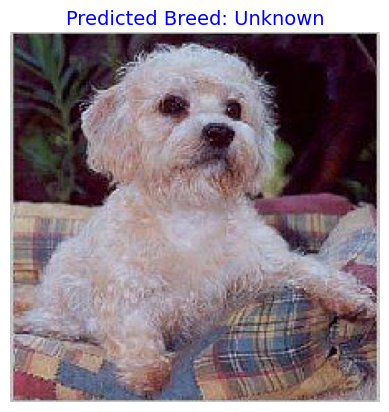

1/1 [==============================] - 0s 52ms/step


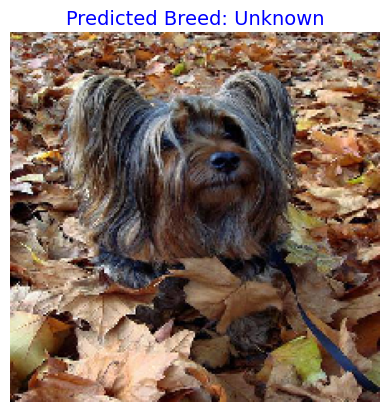

1/1 [==============================] - 0s 51ms/step


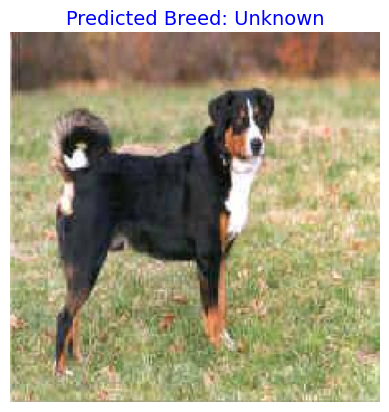

1/1 [==============================] - 0s 50ms/step


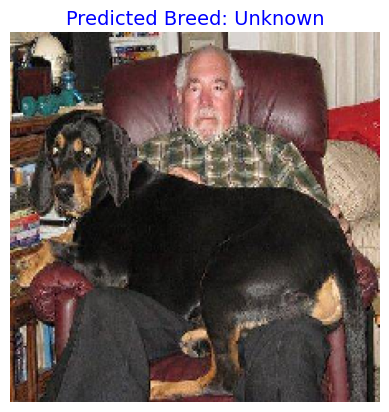

1/1 [==============================] - 0s 51ms/step


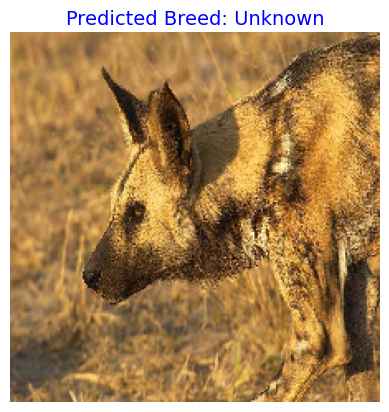

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 68ms/step
                                  Image Predicted Breed
0  e1dd78810048dc387573f2ec50e4bb16.jpg         Unknown
1  e293d06016cac647cd289e2008a4623a.jpg         Unknown
2  e5f2204119380ce1a17fd09435c5012a.jpg         Unknown
3  e527455253416f809a73886b6003020d.jpg         Unknown
4  e386eaa78980be7183ecfdd32ecd2aab.jpg         Unknown


In [15]:
import os
import numpy as np
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt

# Path to the test images directory
test_dir = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/'

# Get list of all image file names in the test directory (assuming they are jpgs)
test_images = [f for f in os.listdir(test_dir) if f.endswith('.jpg')]

# Initialize ImageDataGenerator with only rescaling (no augmentation for inference)
test_datagen = ImageDataGenerator(rescale=1./255)

# Initialize an empty list to store predictions
predictions = []

# Set the limit for displaying images (e.g., only show first 5 images)
max_display = 5
display_count = 0

# Loop through all test images
for img_name in test_images:
    # Load and preprocess the image
    img_path = os.path.join(test_dir, img_name)
    img = image.load_img(img_path, target_size=(224, 224))  # Resize image to the input shape of the model
    img_array = image.img_to_array(img)  # Convert image to array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = img_array / 255.0  # Normalize the image

    # Make a prediction for the current image
    prediction = model.predict(img_array)
    predicted_class_index = np.argmax(prediction, axis=1)  # Get the index of the highest probability

    # Get the corresponding breed name
    predicted_breed = image_label_map.get(predicted_class_index[0], 'Unknown')  # Using your label map

    # Store the prediction
    predictions.append((img_name, predicted_breed))

    # Display the first few images and predictions
    if display_count < max_display:
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Predicted Breed: {predicted_breed}", fontsize=14, color='blue')
        plt.show()
        display_count += 1

# Optionally, save predictions to a CSV
import pandas as pd
pred_df = pd.DataFrame(predictions, columns=['Image', 'Predicted Breed'])
pred_df.to_csv('predictions.csv', index=False)

# Output predictions for all images (can be viewed in CSV or console)
print(pred_df.head())  # Just show the first few rows




In [9]:
# Unfreeze all layers except the base MobileNetV2 layers
for layer in model.layers:
    layer.trainable = True

# Compile the model again
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model on your dog breed data
model.fit(train_data, epochs=5, batch_size=32)  # Adjust this based on your data


NameError: name 'train_data' is not defined

In [7]:
print("Prediction Raw Output:", preds)
print("Predicted Class Index:", np.argmax(preds, axis=1)[0])
print("Predicted Breed:", breed_labels[np.argmax(preds, axis=1)[0]])


Prediction Raw Output: [[1.35071829e-07 1.53940540e-08 8.89202420e-06 2.49012246e-05
  8.23744756e-07 3.42015619e-03 9.64112790e-09 1.31340672e-09
  1.45499880e-05 1.13030999e-11 2.20313741e-08 1.65816709e-05
  1.10409030e-06 6.58099183e-12 6.66055537e-04 2.10104867e-09
  8.37039049e-11 1.09745713e-09 1.72570448e-11 3.73664901e-12
  1.86458874e-05 4.68793502e-08 6.64668971e-12 2.54170209e-05
  4.56156807e-10 8.20177884e-11 1.48789757e-14 1.32445024e-07
  3.49498364e-09 1.37409915e-08 2.04093172e-03 1.72488170e-11
  6.79379284e-01 5.32668805e-11 7.76389497e-04 7.27452516e-08
  1.12340173e-08 1.53309609e-09 1.64287890e-08 1.50718923e-10
  1.15217591e-09 2.92098690e-07 1.26857628e-07 1.54790359e-05
  1.10982489e-02 9.88507165e-10 2.65190874e-06 1.93415881e-10
  2.10127041e-06 4.71001305e-03 7.65103148e-04 3.50942937e-05
  1.21923249e-05 4.93378151e-11 2.71867029e-04 1.59743922e-13
  2.37725732e-08 1.03389830e-08 4.45656012e-11 2.46959218e-07
  1.22806210e-10 1.85808369e-10 4.37231806e-09 

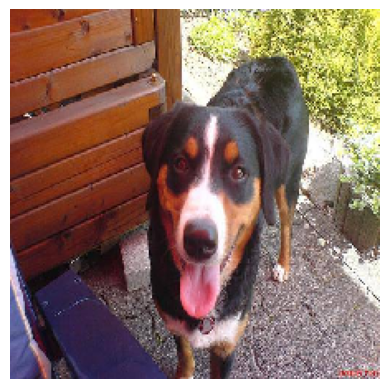

In [21]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from tensorflow.keras.preprocessing import image

# Ensure `img_path` points to the correct image file
img_path = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/test/0aedda5dba90a84794d461b6a2f3daec.jpg'  # Update this with the path of the test image
# Resize image to match model input size (224x224)
img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size

# Convert image to array
img_array = image.img_to_array(img)  # Convert the image to an array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array = img_array / 255.0  # Normalize the image

# Display the image
plt.imshow(img_array[0])
plt.axis("off")  # Hide axes
plt.show()




1/1 [==============================] - 0s 123ms/step


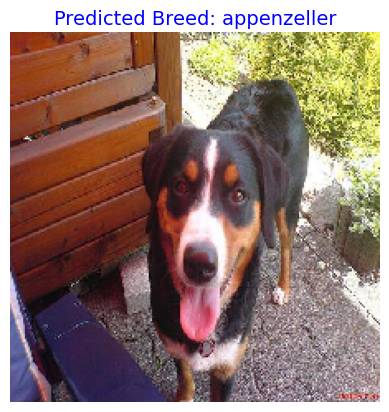

Prediction array: [[1.0653838e-10 1.7605693e-10 2.9100108e-10 3.5891458e-07 3.8271992e-06
  8.4617311e-01 1.1468235e-08 8.9841126e-07 7.8594056e-08 1.5576725e-07
  3.9226467e-08 1.0701425e-04 3.6014910e-08 3.5740435e-08 3.4425747e-09
  2.0419040e-07 1.2850407e-08 9.9335338e-08 1.7305350e-11 3.2600417e-07
  5.4502486e-10 1.2800967e-08 1.2746660e-08 1.6708007e-11 4.8475084e-07
  3.7439958e-07 7.0175188e-10 8.8058954e-08 2.5405751e-07 2.5843105e-10
  7.3131479e-09 1.2091051e-09 2.6173633e-10 9.9307677e-08 2.7675371e-09
  3.3288433e-10 4.7080499e-07 1.3155997e-08 1.1054979e-06 3.2984449e-09
  2.2053424e-08 7.7648750e-09 4.3640602e-02 7.1496929e-06 1.6160276e-09
  5.0888960e-11 6.3794805e-09 7.6880763e-10 6.0590996e-06 1.3577051e-09
  1.2145583e-08 1.5200464e-10 1.4138535e-06 1.0985035e-01 5.5400068e-10
  1.6518473e-07 5.8121480e-10 1.8942123e-10 1.5755397e-12 2.9141424e-07
  3.9199109e-11 5.7161925e-10 1.2887628e-10 1.0738289e-06 4.2533987e-08
  1.2480015e-07 4.9477946e-09 1.4228019e-07 1.

In [22]:
# Get the prediction for the image
preds = model.predict(img_array)  # Predict the class for this single image
predicted_index = np.argmax(preds, axis=1)[0]  # Get the index of the highest probability
predicted_breed = breed_labels[predicted_index]  # Get the breed label from the index

# Display the predicted breed in the title
plt.imshow(img_array[0])  # Show the image again
plt.axis("off")  # Hide axes
plt.title(f"Predicted Breed: {predicted_breed}", fontsize=14, color='blue')
plt.show()

# Print out prediction details for debugging
print(f"Prediction array: {preds}")  # Print prediction array to check its structure
print(f"Predicted Breed Index: {predicted_index}")

1/1 [==============================] - 0s 76ms/step


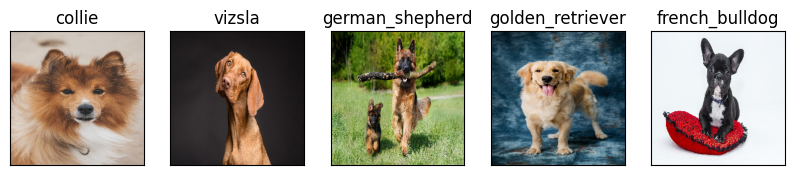

In [23]:
import os
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np

# Define the directory where your custom images are located
custom_images_dir = '/content/drive/MyDrive/Colab Notebooks/ZTM Machine Learning Colab Notebooks/dog_breed_classification/custom_images'

# Load and preprocess the custom images
custom_images = []
custom_pred_labels = []

# List the images in the directory (assuming images are named 'dog_1.jpg', 'dog_2.jpg', ...)
for i in range(1, 6):  # Assuming dog_1.jpg to dog_5.jpg
    img_path = os.path.join(custom_images_dir, f'dog_{i}.jpg')
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to 224x224
    img_array = image.img_to_array(img)  # Convert to array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = img_array / 255.0  # Normalize the image

    # Make prediction using your trained model
    preds = model.predict(img_array)  # Predict the breed
    predicted_index = np.argmax(preds, axis=1)[0]  # Get the index of the highest probability
    predicted_breed = breed_labels[predicted_index]  # Get the breed label from the index

    # Store the image and predicted label
    custom_images.append(img)
    custom_pred_labels.append(predicted_breed)

# Display the images with their predicted labels
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
    plt.subplot(1, 5, i + 1)  # Display images in a row
    plt.xticks([])  # Remove x-axis ticks
    plt.yticks([])  # Remove y-axis ticks
    plt.title(custom_pred_labels[i])  # Display the predicted breed label
    plt.imshow(image)  # Show the image
plt.show()
